Função de Rosenbrock

$$
f(x1,x2) = 100(x_2 − x_1^2)^2 + (1 − x_1)^2
$$

In [1]:
import numpy as np

In [2]:
rosenbrock = lambda x1, x2: (x2 - x1**2)**2 + (1 - x1)**2
generate_solution = lambda: np.random.random()

In [3]:
# Defining the lists to track the optimization process
x1_values = []
x2_values = []
rosenbrock_values = []

# Random initial solution
x1 = generate_solution()
x2 = generate_solution()
x1_values.append(x1)
x2_values.append(x2)
rosenbrock_values.append(rosenbrock(x1,x2))

# Defining the criteria as iterations
total_iterations = 1000

# Defining the probability and actual iteration constants
p = 0.3
t = 0

while t < total_iterations:
    if np.random.random() < 0.8:
        x1 = generate_solution()
        x2 = generate_solution()
        print("x1: ", x1)
        print("x2: ", x2)

        x1_values.append(x1)
        x2_values.append(x2)
        print("x1_value: ", x1_values)
        print("x2_value: ", x2_values)
        
        rosenbrock_values.append(rosenbrock(x1,x2))
    else:
        x1_values.append(x1)
        x2_values.append(x2)
        rosenbrock_values.append(rosenbrock(x1,x2))

    min_rosenbrock_index = rosenbrock_values.index(min(rosenbrock_values))
    optimal_x1 = x1_values[min_rosenbrock_index]
    optimal_x2 = x2_values[min_rosenbrock_index]
    
    print(f"Iteration: {t+1}      Best Solution: ({optimal_x1}, {optimal_x2})      Minimum value: {min(rosenbrock_values)}")
    t += 1

Iteration: 1      Best Solution: (0.3373235602574648, 0.24861099721685298)      Minimum value: 0.45731752431799383
x1:  0.8976310967404801
x2:  0.3537092927353951
x1_value:  [0.3373235602574648, 0.3373235602574648, 0.8976310967404801]
x2_value:  [0.24861099721685298, 0.24861099721685298, 0.3537092927353951]
Iteration: 2      Best Solution: (0.8976310967404801, 0.3537092927353951)      Minimum value: 0.21481258635991168
x1:  0.831093271865082
x2:  0.5683942513080936
x1_value:  [0.3373235602574648, 0.3373235602574648, 0.8976310967404801, 0.831093271865082]
x2_value:  [0.24861099721685298, 0.24861099721685298, 0.3537092927353951, 0.5683942513080936]
Iteration: 3      Best Solution: (0.831093271865082, 0.5683942513080936)      Minimum value: 0.04349209950498306
x1:  0.5544355062749199
x2:  0.654089953988372
x1_value:  [0.3373235602574648, 0.3373235602574648, 0.8976310967404801, 0.831093271865082, 0.5544355062749199]
x2_value:  [0.24861099721685298, 0.24861099721685298, 0.3537092927353951, 

In [15]:
import numpy as np

# Definindo a função OACE
def normalize(metric, min_val, max_val):
    return (metric - min_val) / (max_val - min_val)

def calculate_A(metrics, weights):
    return sum(w * m for w, m in zip(weights, metrics))

def calculate_C(metrics, weights):
    return -sum(w * m for w, m in zip(weights, metrics))

def oace_score(A, C, lambda_):
    return lambda_ * A + (1 - lambda_) * C

# Função para gerar uma solução aleatória (hiperparâmetros)
def generate_solution():
    return np.random.random(size=3)  # Exemplo com 3 hiperparâmetros

# Função para calcular as métricas de assertividade e custo para uma solução
def evaluate_solution(solution):
    # Exemplo de cálculo de métricas (substituir pelo cálculo real)
    assertiveness_metrics = [solution[0], solution[1], solution[2]]
    cost_metrics = [1 - solution[0], 1 - solution[1], 1 - solution[2]]
    
    # Normalizar métricas (exemplo de valores min e max)
    normalized_assertiveness_metrics = [normalize(m, 0, 1) for m in assertiveness_metrics]
    normalized_cost_metrics = [normalize(m, 0, 1) for m in cost_metrics]
    
    return normalized_assertiveness_metrics, normalized_cost_metrics

# Parâmetros da função OACE
lambda_ = 0.7
weights_a = [0.5, 0.3, 0.2]  # Pesos para as métricas de assertividade
weights_c = [0.4, 0.4, 0.2]  # Pesos para as métricas de custo

# Inicializando listas para rastrear o processo de otimização
solutions = []
oace_scores = []

# Solução inicial aleatória
solution = generate_solution()
solutions.append(solution)
A, C = evaluate_solution(solution)

score = oace_score(calculate_A(A, weights_a), calculate_C(C, weights_c), lambda_)
oace_scores.append(score)

# Definindo o número total de iterações
total_iterations = 1000

# Random Walk
for t in range(total_iterations):
    new_solution = generate_solution()
    print("random: ", new_solution)
    solutions.append(new_solution)
    print("solutions: ", solutions)
    A, C = evaluate_solution(new_solution)
    print(A)
    print(C)
    new_score = oace_score(calculate_A(A, weights_a), calculate_C(C, weights_c), lambda_)
    oace_scores.append(new_score)
    
    # Encontrar a melhor solução até agora
    max_oace_index = np.argmax(oace_scores)
    optimal_solution = solutions[max_oace_index]
    
    print(f"Iteration: {t+1}      Best Solution: {optimal_solution}      Maximum OACE Score: {oace_scores[max_oace_index]}")

# Resultado final
print("Melhor solução encontrada:", optimal_solution)
print("Score OACE máximo:", oace_scores[max_oace_index])


random:  [0.98526396 0.17225382 0.83015467]
solutions:  [array([0.01189108, 0.37541052, 0.45876797]), array([0.98526396, 0.17225382, 0.83015467])]
[np.float64(0.9852639628112794), np.float64(0.17225381644805915), np.float64(0.8301546719294278)]
[np.float64(0.01473603718872063), np.float64(0.8277461835519409), np.float64(0.16984532807057218)]
Iteration: 1      Best Solution: [0.98526396 0.17225382 0.83015467]      Maximum OACE Score: 0.38594875633504633
random:  [0.55010685 0.8024633  0.78719543]
solutions:  [array([0.01189108, 0.37541052, 0.45876797]), array([0.98526396, 0.17225382, 0.83015467]), array([0.55010685, 0.8024633 , 0.78719543])]
[np.float64(0.550106853397782), np.float64(0.8024632965050861), np.float64(0.7871954334216811)]
[np.float64(0.449893146602218), np.float64(0.19753670349491392), np.float64(0.21280456657831892)]
Iteration: 2      Best Solution: [0.98526396 0.17225382 0.83015467]      Maximum OACE Score: 0.38594875633504633
random:  [0.16551753 0.30779663 0.826772  ]


In [5]:
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import load_iris
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score
import random

# Definindo a função OACE
def normalize(metric, min_val, max_val):
    return (metric - min_val) / (max_val - min_val)

def calculate_A(metrics, weights):
    return sum(w * m for w, m in zip(weights, metrics))

def calculate_C(metrics, weights):
    return -sum(w * m for w, m in zip(weights, metrics))

def oace_score(A, C, lambda_):
    return lambda_ * A + (1 - lambda_) * C

# Função para gerar uma solução aleatória (hiperparâmetros)
def generate_solution():
    n_estimators = random.randint(10, 200)
    max_depth = random.randint(1, 20)
    min_samples_split = random.uniform(0.1, 1.0)
    return [n_estimators, max_depth, min_samples_split]

# Função para avaliar o modelo com uma configuração de hiperparâmetros
def evaluate_solution(solution, X_train, X_test, y_train, y_test):
    n_estimators, max_depth, min_samples_split = solution
    model = RandomForestClassifier(n_estimators=n_estimators, max_depth=max_depth, min_samples_split=min_samples_split)
    model.fit(X_train, y_train)
    
    # Métricas de assertividade
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    
    # Métricas de custo (exemplo simples)
    inference_time = 1 / n_estimators  # Inversamente proporcional ao número de estimadores
    model_size = n_estimators * max_depth * min_samples_split  # Tamanho do modelo como proxy simples
    
    # Normalizar métricas (exemplo de valores min e max)
    normalized_assertiveness_metrics = [normalize(m, 0, 1) for m in [accuracy, precision, recall]]
    normalized_cost_metrics = [normalize(m, 0, 1) for m in [inference_time, model_size, model_size]]
    
    return normalized_assertiveness_metrics, normalized_cost_metrics

# Parâmetros da função OACE
lambda_ = 0.7
weights_a = [0.5, 0.3, 0.2]  # Pesos para as métricas de assertividade
weights_c = [0.4, 0.4, 0.2]  # Pesos para as métricas de custo

iris = load_iris()
X = iris.data
y = iris.target
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Inicializando listas para rastrear o processo de otimização
solutions = []
oace_scores = []

# Solução inicial aleatória
solution = generate_solution()
print("solution: ", solution)
solutions.append(solution)
A, C = evaluate_solution(solution, X_train, X_test, y_train, y_test)
score = oace_score(calculate_A(A, weights_a), calculate_C(C, weights_c), lambda_)
oace_scores.append(score)

# Definindo o número total de iterações
total_iterations = 100

# Função para realizar um passo do Random Walk
def random_walk_step(solution, step_size=0.1):
    new_solution = solution.copy()
    new_solution[0] = min(max(new_solution[0] + random.randint(-20, 20), 10), 200)  # n_estimators
    new_solution[1] = min(max(new_solution[1] + random.randint(-2, 2), 1), 20)  # max_depth
    new_solution[2] = min(max(new_solution[2] + random.uniform(-0.1, 0.1), 0.1), 1.0)  # min_samples_split
    return new_solution

# Random Walk
for t in range(total_iterations):
    # Realizar um passo do Random Walk
    new_solution = random_walk_step(solution)
    solutions.append(new_solution)
    print("solutions: ", solutions)
    A, C = evaluate_solution(new_solution, X_train, X_test, y_train, y_test)
    print("A: ", A)
    print("C: ", C)
    new_score = oace_score(calculate_A(A, weights_a), calculate_C(C, weights_c), lambda_)
    oace_scores.append(new_score)
    print("S: ", score)
    print("scores: ", oace_scores)
    
    # Encontrar a melhor solução até agora
    max_oace_index = np.argmax(oace_scores)
    optimal_solution = solutions[max_oace_index]
    
    print(f"Iteration: {t+1}      Best Solution: {optimal_solution}      Maximum OACE Score: {oace_scores[max_oace_index]}")
    
    # Atualizar a solução atual para a próxima iteração
    solution = new_solution

# Resultado final
print("Melhor solução encontrada:", optimal_solution)
print("Score OACE máximo:", oace_scores[max_oace_index])


solution:  [152, 16, 0.9403816475796013]
solutions:  [[152, 16, 0.9403816475796013], [144, 17, 0.9427031821857604]]
A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.006944444444444444, 2307.7373899907416, 2307.7373899907416]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669)]
Iteration: 1      Best Solution: [152, 16, 0.9403816475796013]      Maximum OACE Score: -411.4963595181305
solutions:  [[152, 16, 0.9403816475796013], [144, 17, 0.9427031821857604], [138, 16, 0.9559974107793004]]


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.007246376811594203, 2110.8422830006953, 2110.8422830006953]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426)]
Iteration: 2      Best Solution: [138, 16, 0.9559974107793004]      Maximum OACE Score: -379.7865805053426
solutions:  [[152, 16, 0.9403816475796013], [144, 17, 0.9427031821857604], [138, 16, 0.9559974107793004], [151, 14, 0.879210540708058]]
A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.006622516556291391, 1858.6510830568348, 1858.6510830568348]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707)]
Iteration: 3      Best Solution: [151, 14, 0.879210540708058]      Maximum OACE Score: -334.39208965221707
solutions:  [[152, 16, 0.9403816475796013], [144, 17, 0.9427031821857604], [138, 16, 0.9559974107793004], [151, 14, 0.879210540708058],

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3333333333333333, np.float64(0.1111111111111111), np.float64(0.3333333333333333)]
C:  [0.005813953488372093, 2951.880435288015, 2951.880435288015]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949)]
Iteration: 5      Best Solution: [151, 14, 0.879210540708058]      Maximum OACE Score: -334.39208965221707
solutions:  [[152, 16, 0.9403816475796013], [144, 17, 0.9427031821857604], [138, 16, 0.9559974107793004], [151, 14, 0.879210540708058], [157, 16, 0.8548716779753275], [172, 18, 0.9534497530000049], [176, 18, 0.8951660172323664]]
A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.005681818181818182, 2835.885942592137, 2835.885942592137]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.005847953216374269, 2565.0, 2565.0]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949), np.float64(-510.29425148476656), np.float64(-477.360463001728), np.float64(-461.534801754386)]
Iteration: 8      Best Solution: [151, 14, 0.879210540708058]      Maximum OACE Score: -334.39208965221707
solutions:  [[152, 16, 0.9403816475796013], [144, 17, 0.9427031821857604], [138, 16, 0.9559974107793004], [151, 14, 0.879210540708058], [157, 16, 0.8548716779753275], [172, 18, 0.9534497530000049], [176, 18, 0.8951660172323664], [157, 17, 0.9939752688699841], [171, 15, 1.0], [154, 13, 1.0]]
A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.006493506493506494, 2002.0, 2002.0]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.flo

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.006711409395973154, 2384.0, 2384.0]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949), np.float64(-510.29425148476656), np.float64(-477.360463001728), np.float64(-461.534801754386), np.float64(-360.1948792207793), np.float64(-357.6749450704226), np.float64(-428.9549053691276)]
Iteration: 11      Best Solution: [151, 14, 0.879210540708058]      Maximum OACE Score: -334.39208965221707
solutions:  [[152, 16, 0.9403816475796013], [144, 17, 0.9427031821857604], [138, 16, 0.9559974107793004], [151, 14, 0.879210540708058], [157, 16, 0.8548716779753275], [172, 18, 0.9534497530000049], [176, 18, 0.8951660172323664], [157, 17, 0.9939752688699841], [171, 15, 1.0], [154, 13, 1.0], [142, 14, 1.0], [149, 16, 1.0], [140, 16, 1.0]]
A:  [0.3, np.float64(0.09), np.float64(0.3)]
C

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.006993006993006993, 2574.0, 2574.0]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949), np.float64(-510.29425148476656), np.float64(-477.360463001728), np.float64(-461.534801754386), np.float64(-360.1948792207793), np.float64(-357.6749450704226), np.float64(-428.9549053691276), np.float64(-403.0349571428572), np.float64(-459.37678326774767), np.float64(-463.1549391608393)]
Iteration: 14      Best Solution: [151, 14, 0.879210540708058]      Maximum OACE Score: -334.39208965221707
solutions:  [[152, 16, 0.9403816475796013], [144, 17, 0.9427031821857604], [138, 16, 0.9559974107793004], [151, 14, 0.879210540708058], [157, 16, 0.8548716779753275], [172, 18, 0.9534497530000049], [176, 18, 0.8951660172323664], [157, 17, 0.9939752688699841], [171, 15, 1.0], [154, 13, 1.0

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.006134969325153374, 2282.0, 2282.0]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949), np.float64(-510.29425148476656), np.float64(-477.360463001728), np.float64(-461.534801754386), np.float64(-360.1948792207793), np.float64(-357.6749450704226), np.float64(-428.9549053691276), np.float64(-403.0349571428572), np.float64(-459.37678326774767), np.float64(-463.1549391608393), np.float64(-474.13487419354846), np.float64(-396.73491632653065), np.float64(-410.5948361963191)]
Iteration: 17      Best Solution: [151, 14, 0.879210540708058]      Maximum OACE Score: -334.39208965221707
solutions:  [[152, 16, 0.9403816475796013], [144, 17, 0.9427031821857604], [138, 16, 0.9559974107793004], [151, 14, 0.879210540708058], [157, 16, 0.8548716779753275], [172, 18, 0.953449753000

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.007042253521126761, 1859.089812579108, 1859.089812579108]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949), np.float64(-510.29425148476656), np.float64(-477.360463001728), np.float64(-461.534801754386), np.float64(-360.1948792207793), np.float64(-357.6749450704226), np.float64(-428.9549053691276), np.float64(-403.0349571428572), np.float64(-459.37678326774767), np.float64(-463.1549391608393), np.float64(-474.13487419354846), np.float64(-396.73491632653065), np.float64(-410.5948361963191), np.float64(-394.0141552511416), np.float64(-310.53963558888523), np.float64(-334.471111334662)]
Iteration: 20      Best Solution: [146, 13, 0.9094506312816912]      Maximum OACE Score: -310.53963558888523
solutions:  [[152, 16, 0.9403816475796013], [144, 17, 0.9427031821857604

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.008849557522123894, 1921.0, 1921.0]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949), np.float64(-510.29425148476656), np.float64(-477.360463001728), np.float64(-461.534801754386), np.float64(-360.1948792207793), np.float64(-357.6749450704226), np.float64(-428.9549053691276), np.float64(-403.0349571428572), np.float64(-459.37678326774767), np.float64(-463.1549391608393), np.float64(-474.13487419354846), np.float64(-396.73491632653065), np.float64(-410.5948361963191), np.float64(-394.0141552511416), np.float64(-310.53963558888523), np.float64(-334.471111334662), np.float64(-340.45143090383743), np.float64(-271.2751344827587), np.float64(-348.13503023255817), np.float64(-345.61516194690273)]
Iteration: 24      Best Solution: [116, 13, 1.0]      Maximum OACE Score

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.0136986301369863, 1294.0348561456155, 1294.0348561456155]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949), np.float64(-510.29425148476656), np.float64(-477.360463001728), np.float64(-461.534801754386), np.float64(-360.1948792207793), np.float64(-357.6749450704226), np.float64(-428.9549053691276), np.float64(-403.0349571428572), np.float64(-459.37678326774767), np.float64(-463.1549391608393), np.float64(-474.13487419354846), np.float64(-396.73491632653065), np.float64(-410.5948361963191), np.float64(-394.0141552511416), np.float64(-310.53963558888523), np.float64(-334.471111334662), np.float64(-340.45143090383743), np.float64(-271.2751344827587), np.float64(-348.13503023255817), np.float64(-345.61516194690273), np.float64(-353.39758477335016), np.float64(-272.1

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.012658227848101266, 1034.5082124181438, 1034.5082124181438]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949), np.float64(-510.29425148476656), np.float64(-477.360463001728), np.float64(-461.534801754386), np.float64(-360.1948792207793), np.float64(-357.6749450704226), np.float64(-428.9549053691276), np.float64(-403.0349571428572), np.float64(-459.37678326774767), np.float64(-463.1549391608393), np.float64(-474.13487419354846), np.float64(-396.73491632653065), np.float64(-410.5948361963191), np.float64(-394.0141552511416), np.float64(-310.53963558888523), np.float64(-334.471111334662), np.float64(-340.45143090383743), np.float64(-271.2751344827587), np.float64(-348.13503023255817), np.float64(-345.61516194690273), np.float64(-353.39758477335016), np.float64(-272

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.014285714285714285, 784.1904051524039, 784.1904051524039]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949), np.float64(-510.29425148476656), np.float64(-477.360463001728), np.float64(-461.534801754386), np.float64(-360.1948792207793), np.float64(-357.6749450704226), np.float64(-428.9549053691276), np.float64(-403.0349571428572), np.float64(-459.37678326774767), np.float64(-463.1549391608393), np.float64(-474.13487419354846), np.float64(-396.73491632653065), np.float64(-410.5948361963191), np.float64(-394.0141552511416), np.float64(-310.53963558888523), np.float64(-334.471111334662), np.float64(-340.45143090383743), np.float64(-271.2751344827587), np.float64(-348.13503023255817), np.float64(-345.61516194690273), np.float64(-353.39758477335016), np.float64(-272.1

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.017241379310344827, 438.07566138375216, 438.07566138375216]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949), np.float64(-510.29425148476656), np.float64(-477.360463001728), np.float64(-461.534801754386), np.float64(-360.1948792207793), np.float64(-357.6749450704226), np.float64(-428.9549053691276), np.float64(-403.0349571428572), np.float64(-459.37678326774767), np.float64(-463.1549391608393), np.float64(-474.13487419354846), np.float64(-396.73491632653065), np.float64(-410.5948361963191), np.float64(-394.0141552511416), np.float64(-310.53963558888523), np.float64(-334.471111334662), np.float64(-340.45143090383743), np.float64(-271.2751344827587), np.float64(-348.13503023255817), np.float64(-345.61516194690273), np.float64(-353.39758477335016), np.float64(-272

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.3, np.float64(0.09), np.float64(0.3)]
C:  [0.011494252873563218, 725.7909236740609, 725.7909236740609]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949), np.float64(-510.29425148476656), np.float64(-477.360463001728), np.float64(-461.534801754386), np.float64(-360.1948792207793), np.float64(-357.6749450704226), np.float64(-428.9549053691276), np.float64(-403.0349571428572), np.float64(-459.37678326774767), np.float64(-463.1549391608393), np.float64(-474.13487419354846), np.float64(-396.73491632653065), np.float64(-410.5948361963191), np.float64(-394.0141552511416), np.float64(-310.53963558888523), np.float64(-334.471111334662), np.float64(-340.45143090383743), np.float64(-271.2751344827587), np.float64(-348.13503023255817), np.float64(-345.61516194690273), np.float64(-353.39758477335016), np.float64(-272.1

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

A:  [0.9666666666666667, np.float64(0.9694444444444444), np.float64(0.9666666666666667)]
C:  [0.014705882352941176, 218.71735952945497, 218.71735952945497]
S:  -411.4963595181305
scores:  [np.float64(-411.4963595181305), np.float64(-415.2276635316669), np.float64(-379.7865805053426), np.float64(-334.39208965221707), np.float64(-386.37364224453427), np.float64(-531.1525093595949), np.float64(-510.29425148476656), np.float64(-477.360463001728), np.float64(-461.534801754386), np.float64(-360.1948792207793), np.float64(-357.6749450704226), np.float64(-428.9549053691276), np.float64(-403.0349571428572), np.float64(-459.37678326774767), np.float64(-463.1549391608393), np.float64(-474.13487419354846), np.float64(-396.73491632653065), np.float64(-410.5948361963191), np.float64(-394.0141552511416), np.float64(-310.53963558888523), np.float64(-334.471111334662), np.float64(-340.45143090383743), np.float64(-271.2751344827587), np.float64(-348.13503023255817), np.float64(-345.61516194690273), np.f

C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 1      Best Solution: [145, 8, 0.8224164870671269]      Maximum OACE Score: -171.55549008582304
Iteration: 2      Best Solution: [145, 8, 0.8224164870671269]      Maximum OACE Score: -171.55549008582304
Iteration: 3      Best Solution: [145, 8, 0.8224164870671269]      Maximum OACE Score: -171.55549008582304


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 4      Best Solution: [145, 8, 0.8224164870671269]      Maximum OACE Score: -171.55549008582304
Iteration: 5      Best Solution: [165, 6, 0.8194012080728341]      Maximum OACE Score: -145.85212255130637
Iteration: 6      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 7      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 8      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 9      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 10      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 11      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 12      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 13      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 14      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 15      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 16      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 17      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 18      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 19      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 20      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 21      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 22      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 23      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 24      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 25      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 26      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 27      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 28      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 29      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 30      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 31      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 32      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 33      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 34      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 35      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 36      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 37      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726
Iteration: 38      Best Solution: [152, 6, 0.8364390972776135]      Maximum OACE Score: -137.14473168277726


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 39      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 40      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 41      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 42      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Iteration: 43      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 44      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 45      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 46      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 47      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 48      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 49      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 50      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 51      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 52      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 53      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 54      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 55      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 56      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 57      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 58      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 59      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 60      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 61      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 62      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 63      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 64      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 65      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 66      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 67      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 68      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 69      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 70      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 71      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 72      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 73      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 74      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 75      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 76      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 77      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 78      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 79      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 80      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 81      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 82      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Iteration: 83      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 84      Best Solution: [94, 11, 0.7347142604765985]      Maximum OACE Score: -136.58039475564922
Iteration: 85      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246
Iteration: 86      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246
Iteration: 87      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246
Iteration: 88      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246
Iteration: 89      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Iteration: 90      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246
Iteration: 91      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246
Iteration: 92      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 93      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246
Iteration: 94      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246
Iteration: 95      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Iteration: 96      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246
Iteration: 97      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246


C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
C:\Users\Lyanh\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} i

Iteration: 98      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246
Iteration: 99      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246
Iteration: 100      Best Solution: [164, 6, 0.6408759801176906]      Maximum OACE Score: -112.81268530576246
Melhor solução encontrada: [164, 6, 0.6408759801176906]
Score OACE máximo: -112.81268530576246


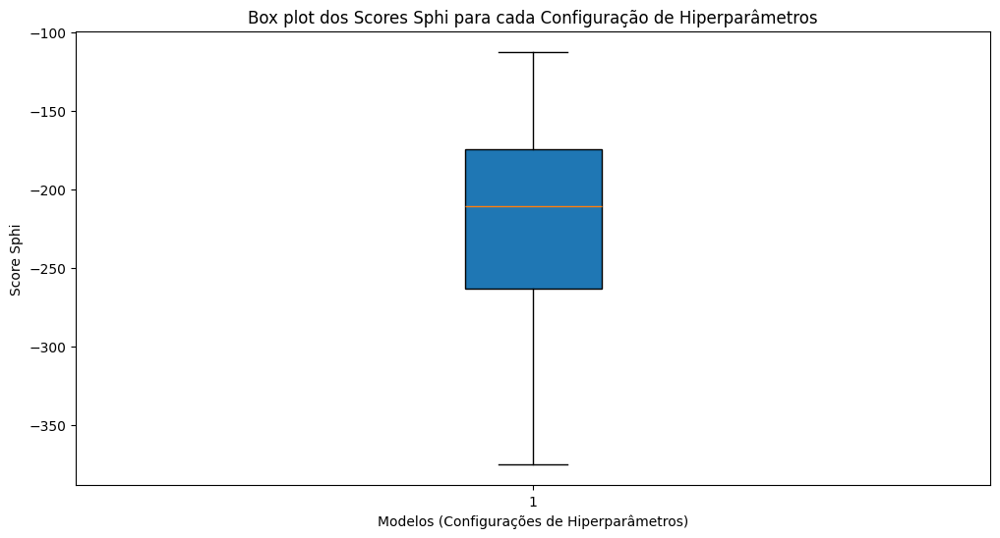

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score
import random

# Definindo a função OACE
def normalize(metric, min_val, max_val):
    return (metric - min_val) / (max_val - min_val)

def calculate_A(metrics, weights):
    return sum(w * m for w, m in zip(weights, metrics))

def calculate_C(metrics, weights):
    return -sum(w * m for w, m in zip(weights, metrics))

def oace_score(A, C, lambda_):
    return lambda_ * A + (1 - lambda_) * C

# Função para gerar uma solução aleatória (hiperparâmetros)
def generate_solution():
    n_estimators = random.randint(10, 200)
    max_depth = random.randint(1, 20)
    min_samples_split = random.uniform(0.1, 1.0)
    return [n_estimators, max_depth, min_samples_split]

# Função para avaliar o modelo com uma configuração de hiperparâmetros
def evaluate_solution(solution, X_train, X_test, y_train, y_test):
    n_estimators, max_depth, min_samples_split = solution
    model = RandomForestClassifier(n_estimators=n_estimators, max_depth=max_depth, min_samples_split=min_samples_split)
    model.fit(X_train, y_train)
    
    # Métricas de assertividade
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    
    # Métricas de custo (exemplo simples)
    inference_time = 1 / n_estimators  # Inversamente proporcional ao número de estimadores
    model_size = n_estimators * max_depth * min_samples_split  # Tamanho do modelo como proxy simples
    
    # Normalizar métricas (exemplo de valores min e max)
    normalized_assertiveness_metrics = [normalize(m, 0, 1) for m in [accuracy, precision, recall]]
    normalized_cost_metrics = [normalize(m, 0, 1) for m in [inference_time, model_size, model_size]]
    
    return normalized_assertiveness_metrics, normalized_cost_metrics

# Parâmetros da função OACE
lambda_ = 0.7
weights_a = [0.5, 0.3, 0.2]  # Pesos para as métricas de assertividade
weights_c = [0.4, 0.4, 0.2]  # Pesos para as métricas de custo

# Carregar dataset
iris = load_iris()
X = iris.data
y = iris.target
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Inicializando listas para rastrear o processo de otimização
solutions = []
oace_scores = []

# Solução inicial aleatória
solution = generate_solution()
solutions.append(solution)
A, C = evaluate_solution(solution, X_train, X_test, y_train, y_test)
score = oace_score(calculate_A(A, weights_a), calculate_C(C, weights_c), lambda_)
oace_scores.append(score)

# Definindo o número total de iterações
total_iterations = 100

# Função para realizar um passo do Random Walk
def random_walk_step(solution, step_size=0.1):
    new_solution = solution.copy()
    new_solution[0] = min(max(new_solution[0] + random.randint(-20, 20), 10), 200)  # n_estimators
    new_solution[1] = min(max(new_solution[1] + random.randint(-2, 2), 1), 20)  # max_depth
    new_solution[2] = min(max(new_solution[2] + random.uniform(-0.1, 0.1), 0.1), 1.0)  # min_samples_split
    return new_solution

# Random Walk
for t in range(total_iterations):
    # Realizar um passo do Random Walk
    new_solution = random_walk_step(solution)
    solutions.append(new_solution)
    A, C = evaluate_solution(new_solution, X_train, X_test, y_train, y_test)
    new_score = oace_score(calculate_A(A, weights_a), calculate_C(C, weights_c), lambda_)
    oace_scores.append(new_score)
    
    # Encontrar a melhor solução até agora
    max_oace_index = np.argmax(oace_scores)
    optimal_solution = solutions[max_oace_index]
    
    print(f"Iteration: {t+1}      Best Solution: {optimal_solution}      Maximum OACE Score: {oace_scores[max_oace_index]}")
    
    # Atualizar a solução atual para a próxima iteração
    solution = new_solution

# Resultado final
print("Melhor solução encontrada:", optimal_solution)
print("Score OACE máximo:", oace_scores[max_oace_index])

# Traçar o box plot dos scores Sphi
plt.figure(figsize=(12, 6))
plt.boxplot(oace_scores, vert=True, patch_artist=True)
plt.title('Box plot dos Scores Sphi para cada Configuração de Hiperparâmetros')
plt.xlabel('Modelos (Configurações de Hiperparâmetros)')
plt.ylabel('Score Sphi')
plt.show()
